# Curve fitting

This notebook will perform a simple Bayesian curve fitting in `julia`. We will use NUTS sampler to sample from the posterior distribution. First, let's load necessary packages.

In [1]:
using Random
using Plots
using Turing
using MCMCChains
using StatsPlots
using Distributions

Now, let's generate fake data. We will use the following function to generate the dataset:

$$ y = \exp{(-5x)} \cdot \sin{(20x)} + 0.5x + 2$$

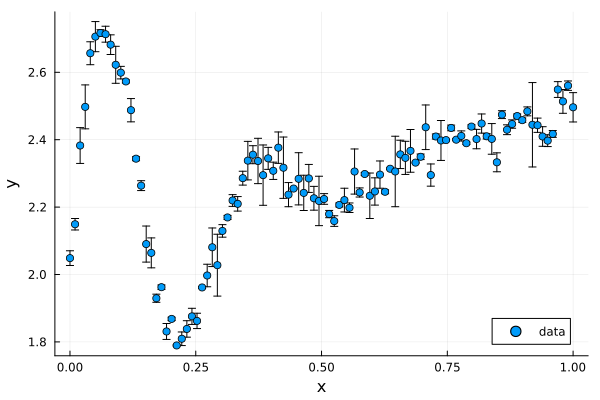

In [2]:
x = range(0., 1., 100)
y = exp.(-5.0 .* x) .* sin.(20.0 .* x) .+ 0.5 .* x .+ 2.0 .+ 0.04*randn(length(x))
yerr = abs.( rand(Normal(0.0, 0.04), length(x)) )

scatter(x, y; yerr=yerr, xlabel="x", ylabel="y", label="data")

Now, we will define "likelihood" function. We will use the model function in the following form:

$$y = \exp{(ax)}\cdot\sin{(bx)} + cx + d$$

The $a$, $b$, $c$, and $d$ are the four obvious free variables. Additionally, we will also fit for the additional white noise (variable $\sigma$).

In [3]:
# Bayesian linear regression.
@model function linear_regression(x1, y1)
    # Set variance prior.
    σ₂ ~ truncated(Normal(0, 100), 0, Inf)
    
    a ~ Uniform(-10, 10)
    b ~ Uniform(0, 50)
    c ~ Uniform(0, 1)
    d ~ Uniform(0, 10)

    # Each point is drawn from a gaussian (Normal) distribution
    # with mean calculated form our model, and standard
    # deviation as the square root of the variance variable + errorbars
    for i in eachindex(x1,y1)
        model = exp.(a .* x1[i]) .* sin.(b .* x1[i]) .+ c .* x1[i] .+ d
        y1[i] ~ Normal(model, sqrt(σ₂ + yerr[i]^2))
    end
end

# Model definition (model calling?)
model = linear_regression(x, y)

DynamicPPL.Model{typeof(linear_regression), (:x1, :y1), (), (), Tuple{StepRangeLen{Float64, Base.TwicePrecision{Float64}, Base.TwicePrecision{Float64}, Int64}, Vector{Float64}}, Tuple{}, DynamicPPL.DefaultContext}(Main.linear_regression, (x1 = 0.0:0.010101010101010102:1.0, y1 = [2.048626036249685, 2.1491563350796645, 2.382820254278653, 2.4974708663126344, 2.6567082177866808, 2.7059480934818843, 2.7167459049008316, 2.7132027841695248, 2.682092442543405, 2.6223622384194565  …  2.48419686229164, 2.4443840423423953, 2.4429814307424116, 2.4095968457266483, 2.3972530847483937, 2.4171874109037153, 2.54897510214297, 2.5137467583516475, 2.5604782363440206, 2.4962082274055852]), NamedTuple(), DynamicPPL.DefaultContext())

And, now we will sample from the posterior distribution using NUTS sampler.

In [4]:
# Actual MCMC routine
chain = sample(model, NUTS(0.65), MCMCDistributed(), 5000, 2)

┌ Warning: Only a single process available: MCMC chains are not sampled in parallel
└ @ AbstractMCMC /Users/japa6985/.julia/packages/AbstractMCMC/fWWW0/src/sample.jl:405
Sampling (1 processes)   0%|                            |  ETA: N/A
┌ Info: Found initial step size
│   ϵ = 0.05
└ @ Turing.Inference /Users/japa6985/.julia/packages/Turing/UCuzt/src/mcmc/hmc.jl:192
Sampling (1 processes)  50%|██████████████              |  ETA: 0:00:17
┌ Info: Found initial step size
│   ϵ = 0.05
└ @ Turing.Inference /Users/japa6985/.julia/packages/Turing/UCuzt/src/mcmc/hmc.jl:192
Sampling (1 processes) 100%|████████████████████████████| Time: 0:00:20
Sampling (1 processes) 100%|████████████████████████████| Time: 0:00:20


Chains MCMC chain (5000×17×2 Array{Float64, 3}):

Iterations        = 1001:1:6000
Number of chains  = 2
Samples per chain = 5000
Wall duration     = 17.08 seconds
Compute duration  = 15.35 seconds
parameters        = σ₂, a, b, c, d
internals         = lp, n_steps, is_accept, acceptance_rate, log_density, hamiltonian_energy, hamiltonian_energy_error, max_hamiltonian_energy_error, tree_depth, numerical_error, step_size, nom_step_size

Summary Statistics
  parameters      mean       std      mcse     ess_bulk    ess_tail      rhat  ⋯
      Symbol   Float64   Float64   Float64      Float64     Float64   Float64  ⋯

          σ₂    0.0011    0.0002    0.0000    9396.6822   6269.2776    1.0001  ⋯
           a   -5.1852    0.1397    0.0013   11218.0825   7196.2232    1.0007  ⋯
           b   19.9676    0.1473    0.0015   10125.5295   6674.7499    1.0000  ⋯
           c    0.4820    0.0143    0.0002    5063.3596   5991.4858    1.0002  ⋯
           d    2.0164    0.0086    0.0001    5373.6818  

And some nice plots:

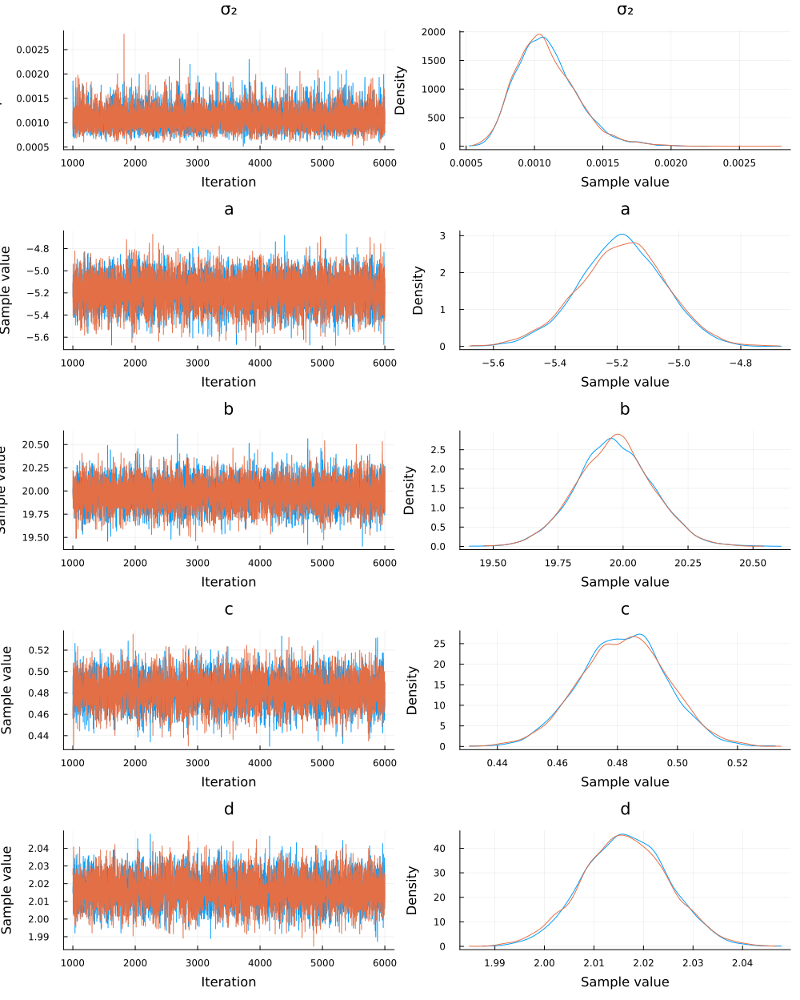

In [5]:
plot(chain)

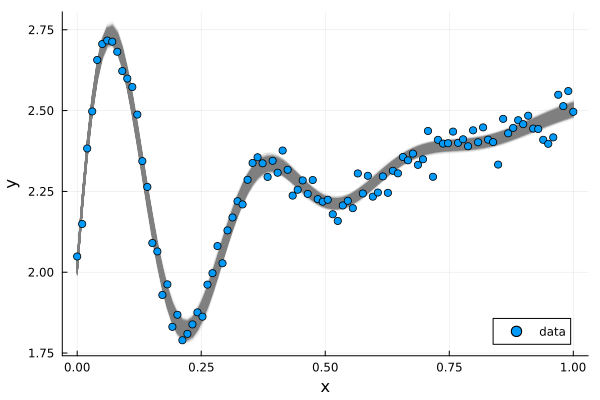

In [6]:
a = [chain["a"].data[:,1]; chain["a"].data[:,2]]
b = [chain["b"].data[:,1]; chain["b"].data[:,2]]
c = [chain["c"].data[:,1]; chain["c"].data[:,2]]
d = [chain["d"].data[:,1]; chain["d"].data[:,2]]
σ₂ = [chain["σ₂"].data[:,1]; chain["σ₂"].data[:,2]]

plot(x, exp.(a' .* x) .* sin.(b' .* x) .+ c' .* x .+ d'; label="", color=:gray, alpha=0.05)
scatter!(x, y, xlabel="x", ylabel="y", label="data", color=1)

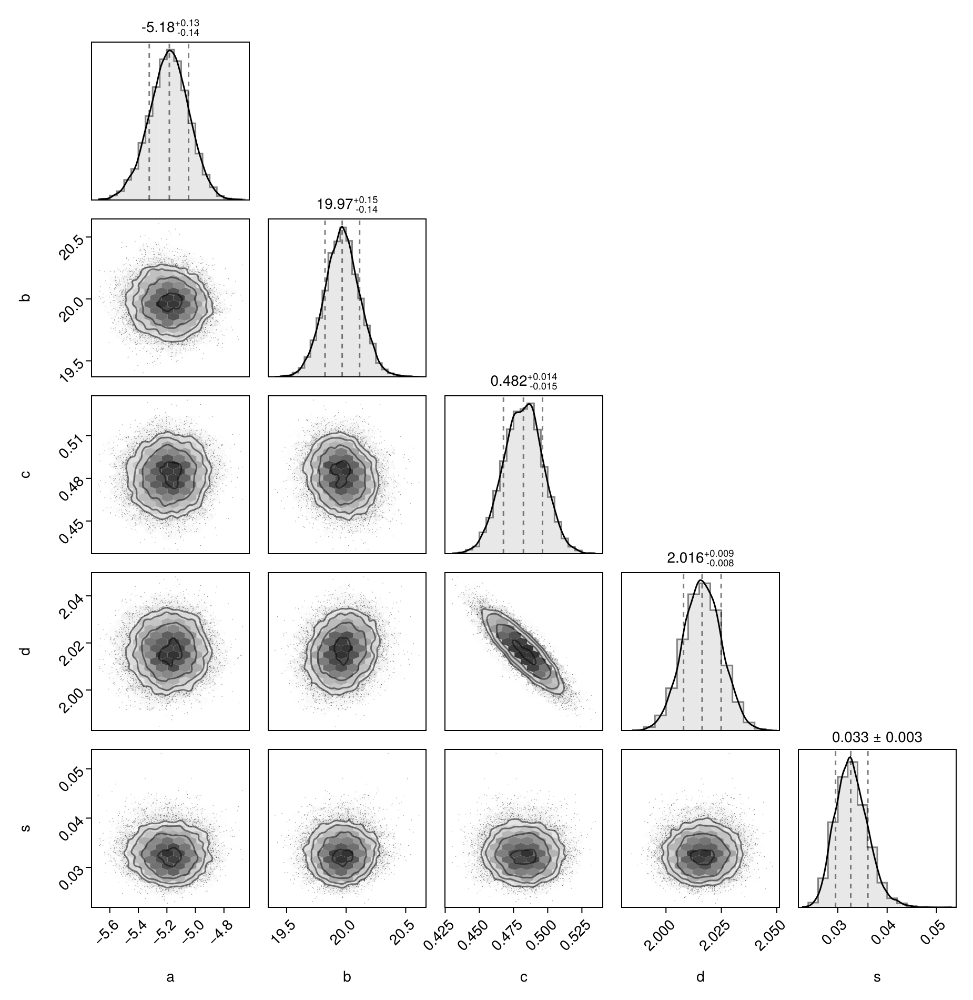

In [7]:
using CairoMakie
using PairPlots

table = (;
    a = a,
    b = b,
    c = c,
    d = d,
    s = sqrt.(σ₂),
)
pairplot(table)